In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import glob
from sklearn.decomposition import PCA
from astropy.io import fits

In [2]:
# fits_file = "tess-s0001-3-3_36.820737_-82.019560_20x20_astrocut.fits"
fits_file = "tess-s0001-3-3_36.820737_-82.019560_64x64_astrocut.fits"
# fits_file = "tess-s0001-3-3_36.820737_-82.019560_100x100_astrocut.fits"

In [3]:
fits.getdata(fits_file, ext=1).columns

ColDefs(
    name = 'TIME'; format = 'D'; unit = 'BJD - 2457000, days'; disp = 'D14.7'
    name = 'TIMECORR'; format = 'E'; unit = 'd'; disp = 'E14.7'
    name = 'CADENCENO'; format = 'J'; disp = 'I10'
    name = 'RAW_CNTS'; format = '4096J'; unit = 'count'; null = -1; disp = 'I8'; dim = '(64, 64)'
    name = 'FLUX'; format = '4096E'; unit = 'e-/s'; disp = 'E14.7'; dim = '(64, 64)'
    name = 'FLUX_ERR'; format = '4096E'; unit = 'e-/s'; disp = 'E14.7'; dim = '(64, 64)'
    name = 'FLUX_BKG'; format = '4096E'; unit = 'e-/s'; disp = 'E14.7'; dim = '(64, 64)'
    name = 'FLUX_BKG_ERR'; format = '4096E'; unit = 'e-/s'; disp = 'E14.7'; dim = '(64, 64)'
    name = 'QUALITY'; format = 'J'; disp = 'B16.16'
    name = 'POS_CORR1'; format = 'E'; unit = 'pixel'; disp = 'E14.7'
    name = 'POS_CORR2'; format = 'E'; unit = 'pixel'; disp = 'E14.7'
    name = 'FFI_FILE'; format = '38A'; unit = 'pixel'
)

In [4]:
with fits.open(fits_file, mode="readonly") as hdulist:
    time = hdulist[1].data["TIME"]
    flux = hdulist[1].data["FLUX"]

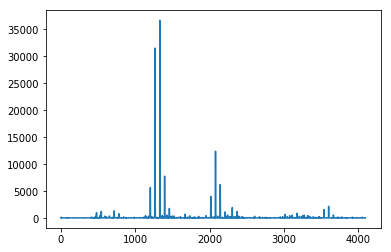

In [5]:
first_image = flux[0]
pixel_side = first_image.shape[0]
plt.plot(first_image.reshape(pixel_side*pixel_side))

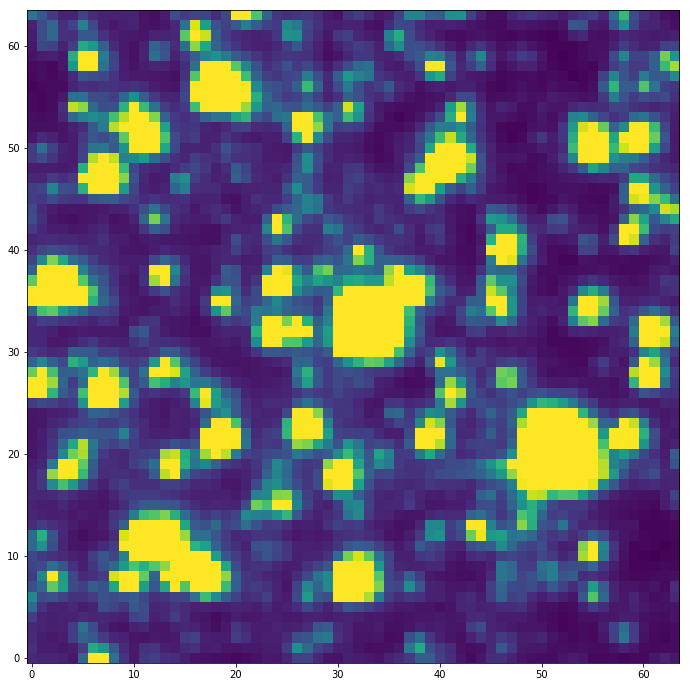

In [74]:
plt.figure(figsize=(12, 12,))

plt.imshow(first_image, origin="lower", 
           vmin=np.percentile(first_image, 0), vmax=np.percentile(first_image, 90))

(4096, 1282)

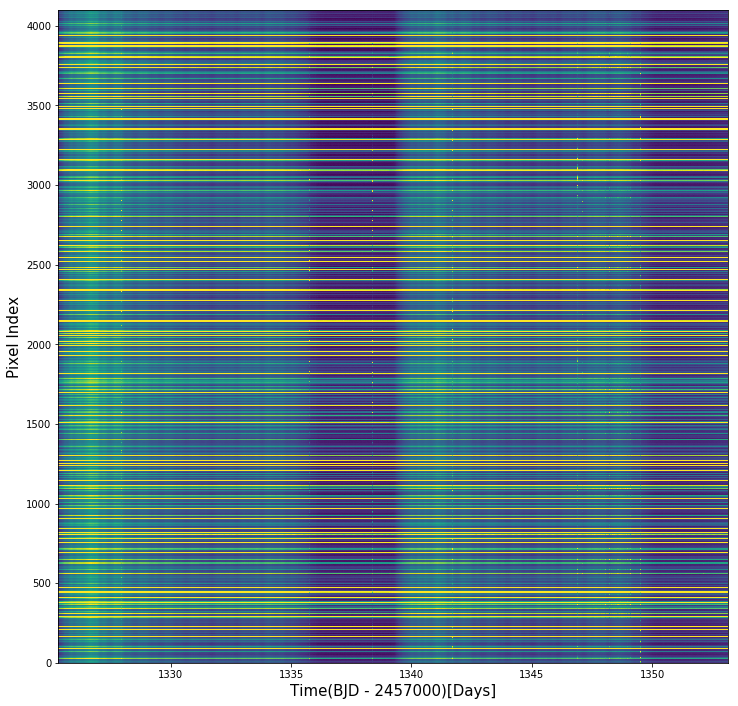

In [7]:
plt.figure(figsize=(12, 12))
collection_images = flux[::]
data_matrix = collection_images.T.reshape(pixel_side*pixel_side, flux.shape[0])
plt.imshow(data_matrix, aspect="auto",
           vmin=np.percentile(data_matrix, 0), vmax=np.percentile(data_matrix, 90),
          origin="lower", extent=[time[0], time[-1], 0, pixel_side**2])
plt.xlabel("Time(BJD - 2457000)[Days]", fontsize=15);
plt.ylabel("Pixel Index", fontsize=15)
data_matrix.shape

In [23]:
k = 8
pca = PCA(n_components = k)
pca.fit(data_matrix)
data_matrix_pca = pca.transform(data_matrix)

In [24]:
pca.components_.shape

(8, 1282)

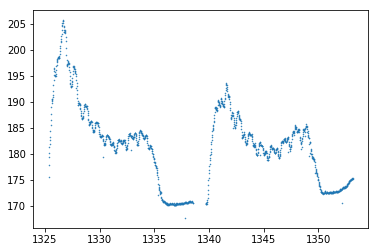

In [41]:
plt.plot(time, pca.mean_, ".", markersize=1)

Text(0.5, 0.92, 'Top 8 Principal Components')

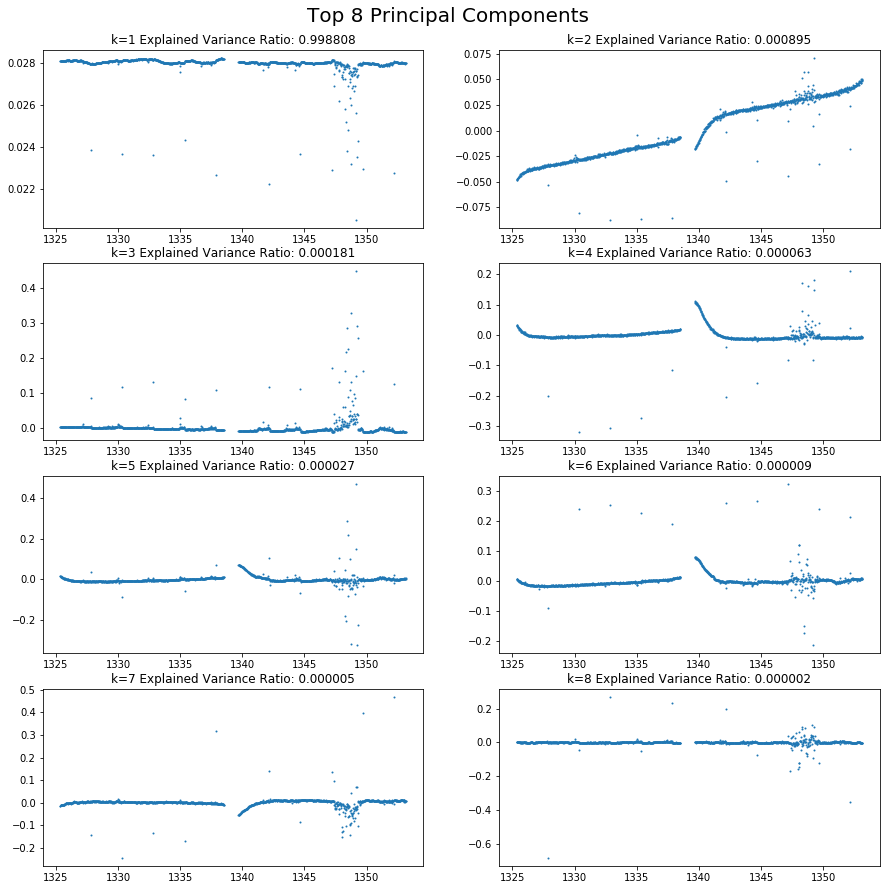

In [40]:
pca_exp_var_ratio = pca.explained_variance_ratio_
fig = plt.figure(figsize=(15, 15))

for i in range(k):
    ax = fig.add_subplot(4, 2, i+1)
    ax.plot(time, pca.components_[i], ".", markersize=2)
    ax.set_title("k={} Explained Variance Ratio: {:.6f}".format(i+1, pca_exp_var_ratio[i]))

# plt.xlabel("Time(BJD - 2457000)[Days]", fontsize=15);
# plt.ylabel("")
plt.suptitle("Top {} Principal Components".format(k), x=0.5, y=0.92,fontsize=20)

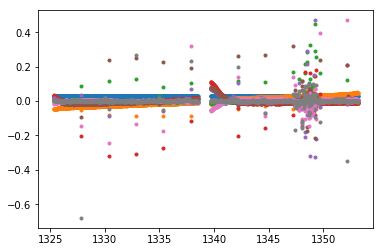

In [211]:
for i in range(k):
    plt.plot(time, pca.components_[i], ".")

In [42]:
reconstruct = pca.inverse_transform(data_matrix_pca)

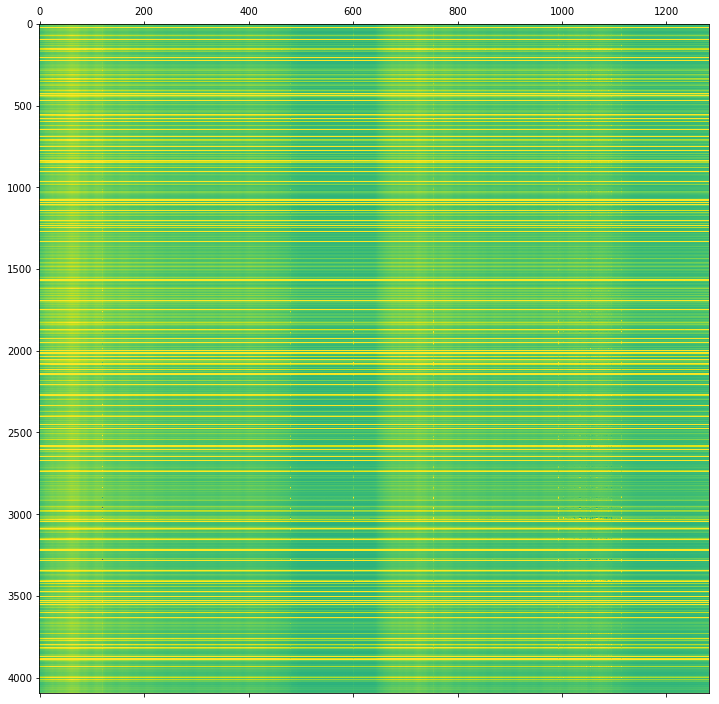

In [76]:
fig = plt.figure(figsize=(12, 12))

plt.matshow(reconstruct, aspect="auto", 
            vmin=np.percentile(reconstruct, 0), vmax=np.percentile(reconstruct, 90), fignum=1)

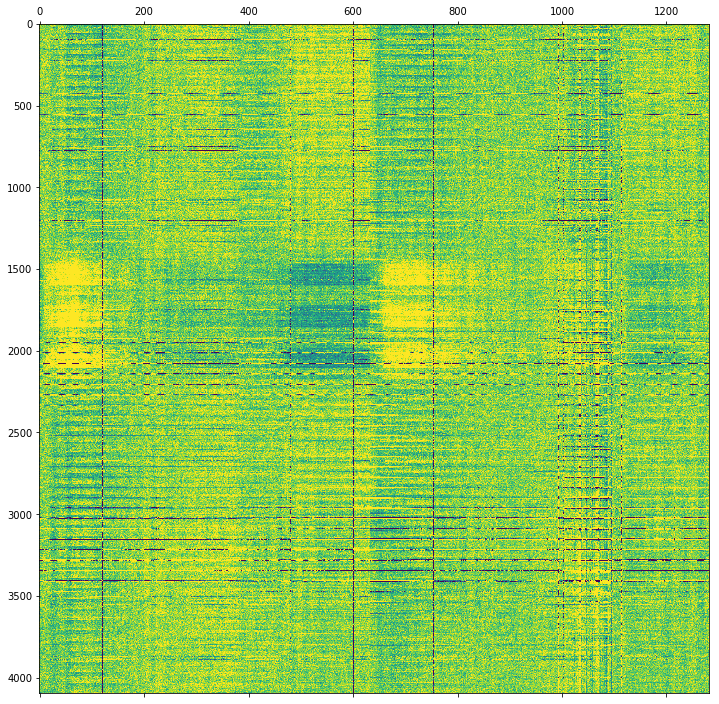

In [78]:
diff = data_matrix - reconstruct

fig = plt.figure(figsize=(12, 12))

plt.matshow(diff, aspect="auto", 
            vmin=np.percentile(diff, 1), vmax=np.percentile(diff, 90), fignum=1)

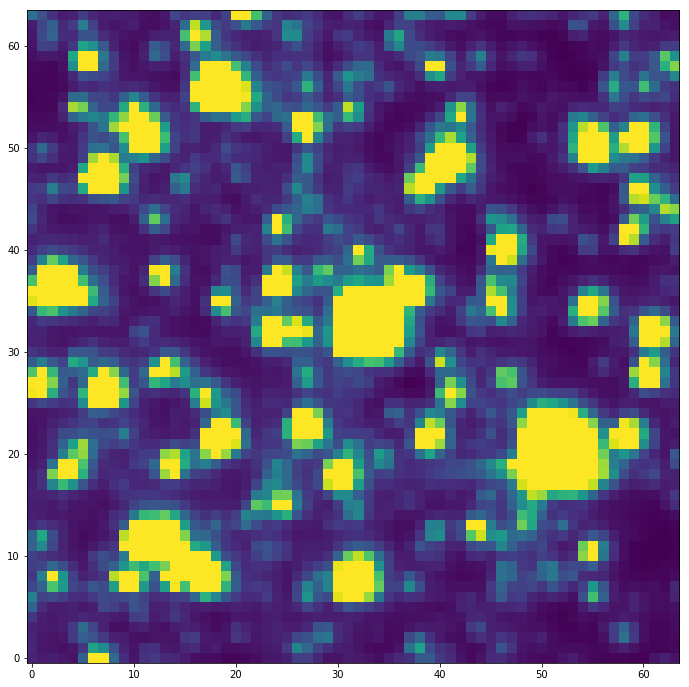

In [80]:
plt.figure(figsize=(12, 12))

recon_image = reconstruct.reshape(pixel_side, pixel_side, flux.shape[0]).T
plt.imshow(recon_image[0], origin="lower", 
           vmin=np.percentile(recon_image[0], 0), vmax=np.percentile(recon_image[1], 90));

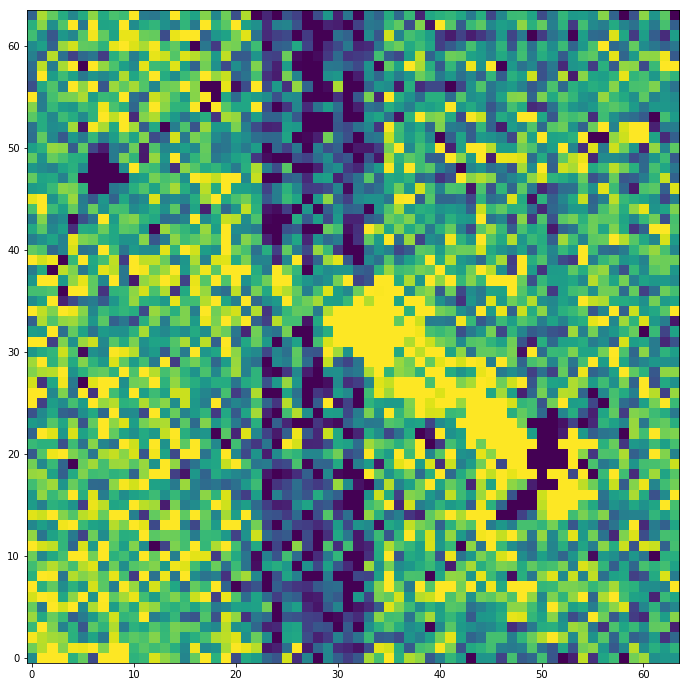

In [90]:
plt.figure(figsize=(12, 12))

diff_image = flux - recon_image
plt.imshow(diff_image[0], origin="lower", 
           vmin=np.percentile(diff_image[0], 5), vmax=np.percentile(diff_image[0], 90))

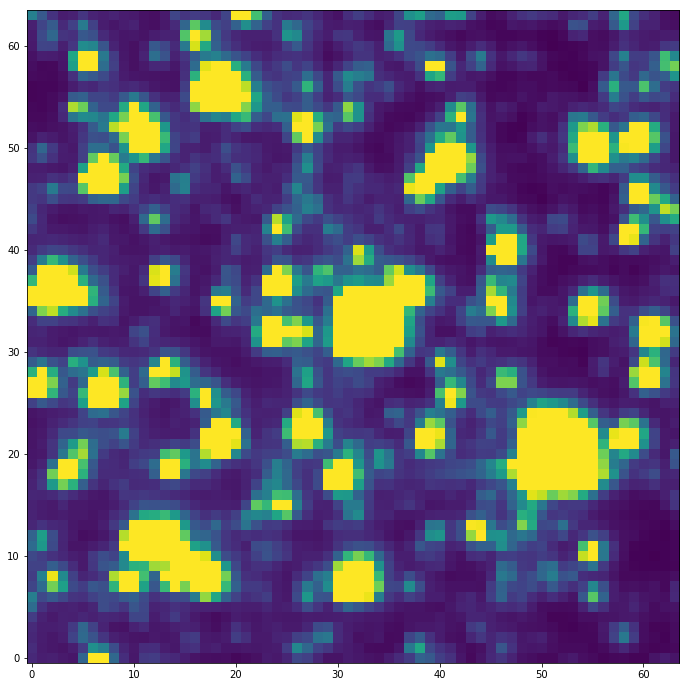

In [171]:
fig = plt.figure(figsize=(12, 12));

ims = []
for i in range(0, flux.shape[0], 4):
    im = plt.imshow(flux[i], origin="lower", animated=True,
                   vmin=np.percentile(flux[0], 0), vmax=np.percentile(flux[1], 90))
    ims.append([im])
    
ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000);

HTML(ani.to_jshtml())

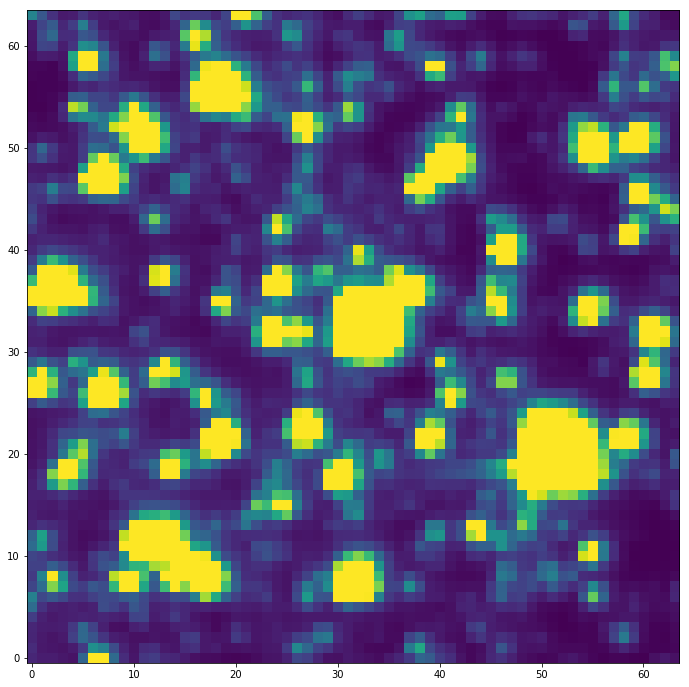

In [169]:
from IPython.display import HTML
# HTML(ani.to_jshtml())

fig = plt.figure(figsize=(12, 12));

ims = []
for i in range(0, flux.shape[0], 4):
    im = plt.imshow(recon_image[i], origin="lower", animated=True,
                   vmin=np.percentile(recon_image[0], 0), vmax=np.percentile(recon_image[0], 90))
    ims.append([im])
    
ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000);

HTML(ani.to_jshtml())

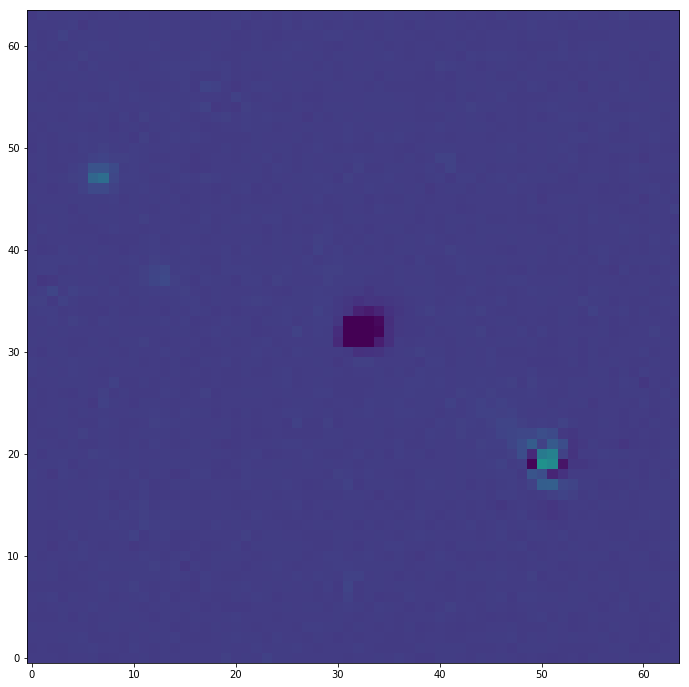

In [172]:
fig = plt.figure(figsize=(12, 12));

ims = []
for i in range(0, flux.shape[0], 4):
    im = plt.imshow(diff_image[i], origin="lower", animated=True,
                   vmin=np.percentile(diff_image[0], 0), vmax=np.percentile(diff_image[0], 100));
    ims.append([im]);
    
ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000);

HTML(ani.to_jshtml())